# Single Video Analysis

## Load Data

First, we load the data and split the dataframe for simpler access.

img00635.jpeg


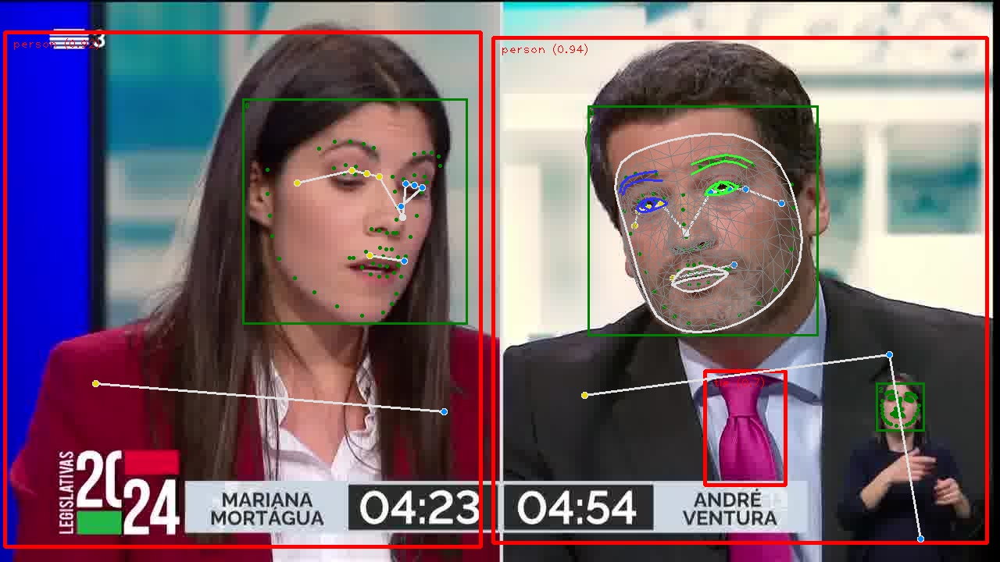

In [20]:
import pandas as pd
import random
import os
from PIL import Image
from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.patches import Rectangle
import numpy as np
from sklearn.decomposition import PCA
from matplotlib.patches import Rectangle
from sklearn.cluster import SpectralClustering


# Load Data
video = 'chega-be'
processed_video_dir = os.path.join('processed')
df = pd.read_pickle(os.path.join(processed_video_dir, video + '.pkl'))

# Split the dataframe for simpler access
filename = df['filename']
detections = df['detections']
poses = df['poses']
faces = df['faces']
text = df['text']
embedding = df['embedding']
fer = df['fer']

print(filename[208])

def display_img(video, filename):
    img = Image.open(os.path.join('processed', video, filename))
    display(img)

display_img(video, filename[208])

## Split the Video into Different Scenes

## Elbow Method

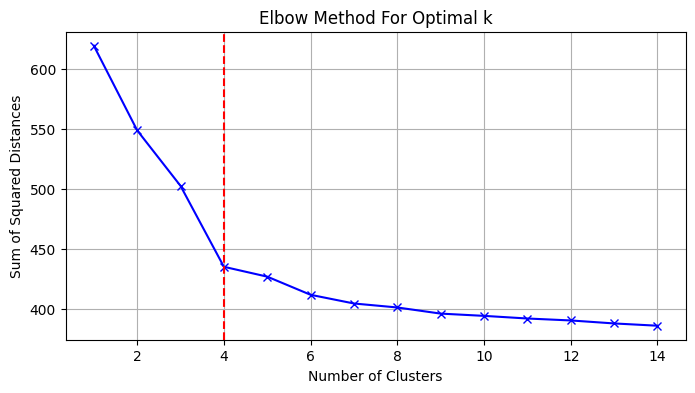

Optimal number of clusters (Elbow Method): 4


In [2]:
# Set random seed for reproducibility
np.random.seed(42)

# Normalize embeddings
embeddings = np.vstack(embedding)  # Convert the column to a 2D NumPy array
norm = np.linalg.norm(embeddings, axis=1, keepdims=True)
normalized_embeddings = embeddings / norm

from kneed import KneeLocator

# Determine the optimal number of clusters using the Elbow Method
K = range(1, 15)
sum_of_squared_distances = []
for k in K:
    km = KMeans(n_clusters=k, random_state=42)
    km = km.fit(normalized_embeddings)
    sum_of_squared_distances.append(km.inertia_)

# Using KneeLocator to find the elbow point
kneedle = KneeLocator(K, sum_of_squared_distances, curve='convex', direction='decreasing')
optimal_k = kneedle.elbow

plt.figure(figsize=(8, 4))
plt.plot(K, sum_of_squared_distances, 'bx-')
plt.axvline(optimal_k, color='r', linestyle='--')
plt.xlabel('Number of Clusters')
plt.ylabel('Sum of Squared Distances')
plt.title('Elbow Method For Optimal k')
plt.grid(True)
plt.show()

print(f'Optimal number of clusters (Elbow Method): {optimal_k}')



Using Davies-Bouldin Index

In [3]:
from sklearn.metrics import silhouette_score

# Determine the optimal number of clusters using Silhouette Score
best_k = 2
best_score = -1

for k in range(2, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    cluster_labels = kmeans.fit_predict(normalized_embeddings)
    silhouette_avg = silhouette_score(normalized_embeddings, cluster_labels)
    if silhouette_avg > best_score:
        best_score = silhouette_avg
        best_k = k

print(f'Optimal number of clusters (Silhouette Score): {best_k}')

Optimal number of clusters (Silhouette Score): 4


We will use clustering to segment the video into different scenes. Let's start with PCA and KMeans clustering.

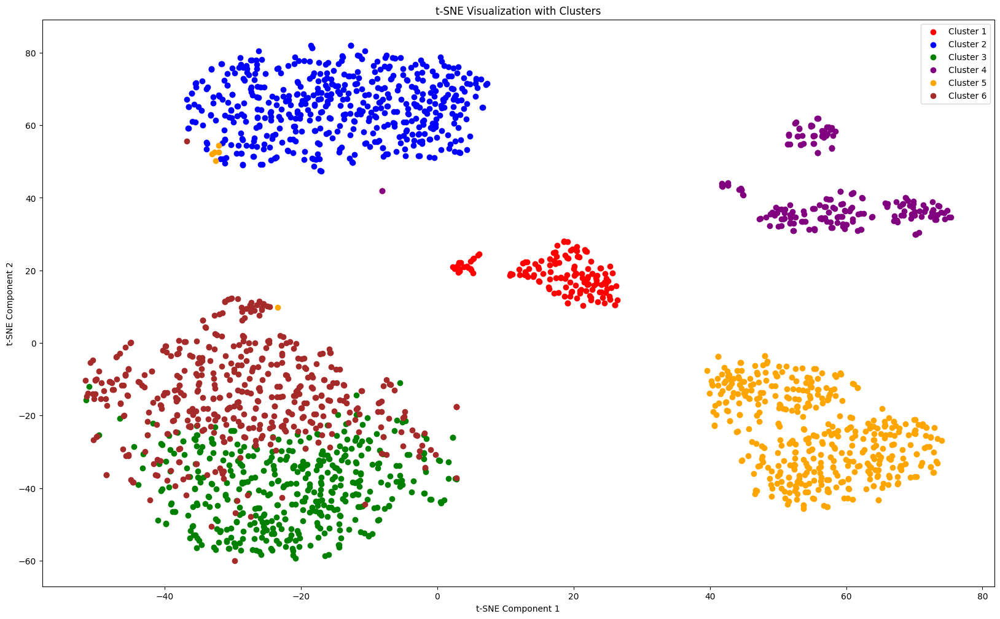

In [57]:
# Assuming optimal number of clusters is determined from the elbow method
num_clusters = 6

# Perform K-means clustering on the normalized embeddings
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
cluster_assignments = kmeans.fit_predict(normalized_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=3000)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'brown']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

## t-SNE Visualization
Next, we use t-SNE for dimensionality reduction and clustering.

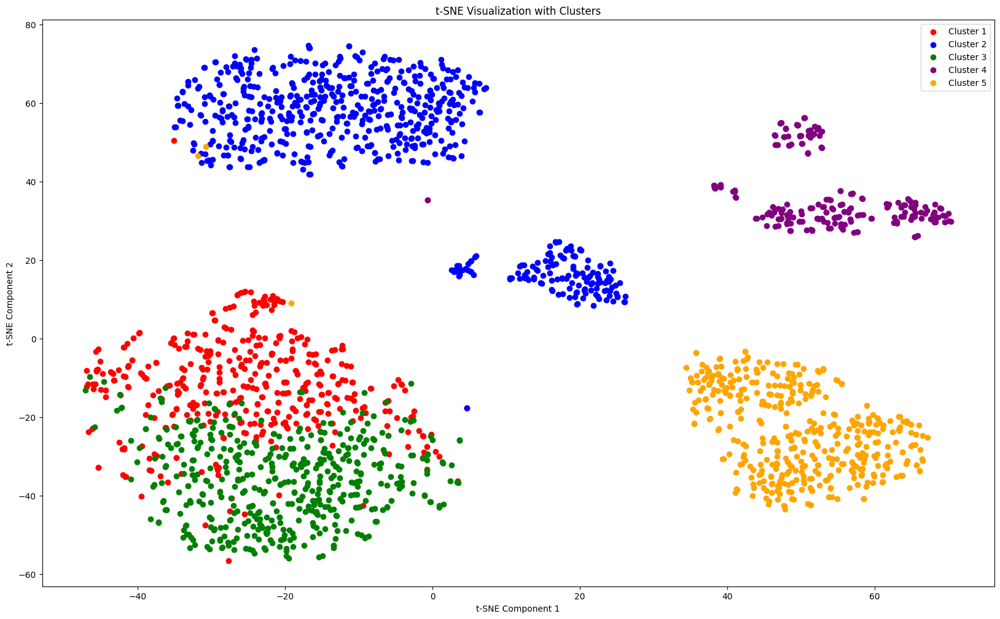

In [5]:
# Perform K-means clustering on the normalized embeddings
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
cluster_assignments = kmeans.fit_predict(normalized_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2000)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

# Spectral Clustering

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-pac

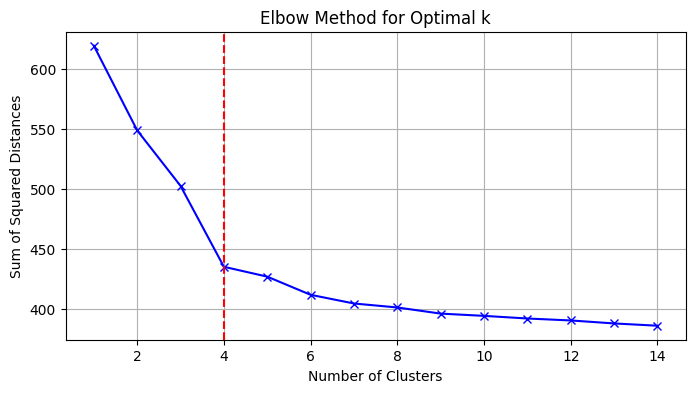

Optimal number of clusters: 4


In [52]:
# Determine the optimal number of clusters using the elbow method
def compute_spectral_inertia(embeddings, k_range):
    inertias = []
    for k in k_range:
        spectral = SpectralClustering(n_clusters=k, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
        cluster_assignments = spectral.fit_predict(embeddings)
        km = KMeans(n_clusters=k, random_state=42)
        km.fit(embeddings)
        inertias.append(km.inertia_)
    return inertias

# Range of clusters to evaluate
k_range = range(1, 15)
inertias = compute_spectral_inertia(normalized_embeddings, k_range)

# Find the elbow point using KneeLocator
kneedle = KneeLocator(k_range, inertias, curve='convex', direction='decreasing')
optimal_clusters = kneedle.elbow

# Plotting the elbow curve
plt.figure(figsize=(8, 4))
plt.plot(k_range, inertias, 'bx-')
plt.axvline(x=optimal_clusters, color='r', linestyle='--')
plt.xlabel('Number of Clusters')
plt.ylabel('Sum of Squared Distances')
plt.title('Elbow Method for Optimal k')
plt.grid(True)
plt.show()

print(f"Optimal number of clusters: {optimal_clusters}")

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


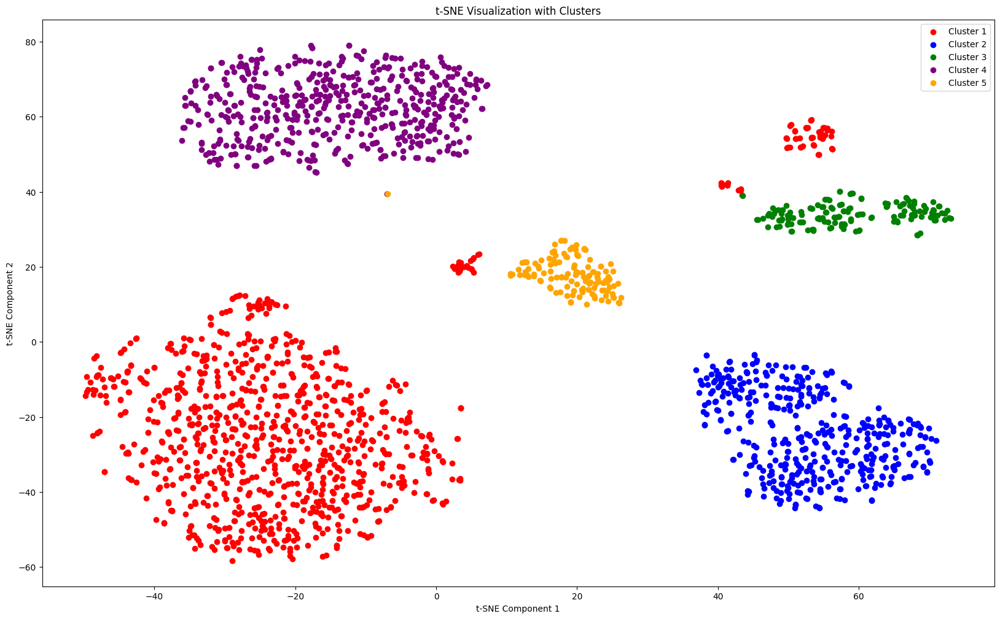

In [81]:
# Normalize embeddings
embeddings = np.vstack(embedding)  # Convert the column to a 2D NumPy array
norm = np.linalg.norm(embeddings, axis=1, keepdims=True)
normalized_embeddings = embeddings / norm

# Perform Spectral Clustering on the normalized embeddings with increased neighbors
num_clusters = 5
spectral = SpectralClustering(n_clusters=num_clusters, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
cluster_assignments = spectral.fit_predict(normalized_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2500)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

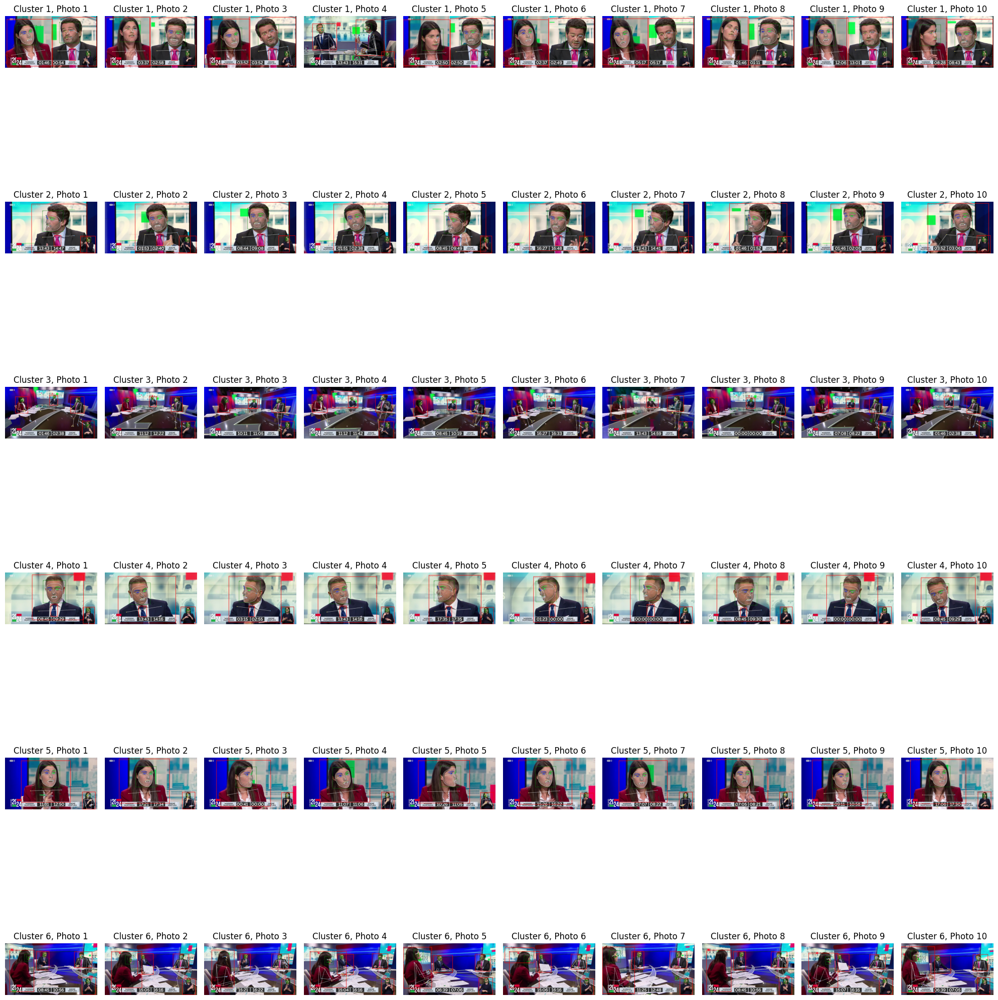

In [79]:
# Function to display 5 random photos from each cluster
def display_img(video, filename):
    img = Image.open(os.path.join('processed', video, filename))
    return img

def display_random_photos_by_cluster(video, scenes, filename, num_photos=5):
    fig, axs = plt.subplots(len(scenes), num_photos, figsize=(20, 4 * len(scenes)))
    for cluster_id, scene in enumerate(scenes):
        random_photos = random.sample(scene, min(num_photos, len(scene)))  # Select random photos or less if not enough photos
        for i, photo_id in enumerate(random_photos):
            image_path = os.path.join('processed', video, filename[photo_id])
            img = display_img(video, filename[photo_id])
            axs[cluster_id, i].imshow(img)
            axs[cluster_id, i].axis('off')
            axs[cluster_id, i].set_title(f'Cluster {cluster_id + 1}, Photo {i + 1}')
    
    plt.tight_layout()
    plt.show()

# Display random photos from each cluster
display_random_photos_by_cluster(video, scenes, filename, num_photos=10)

### With pictures

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


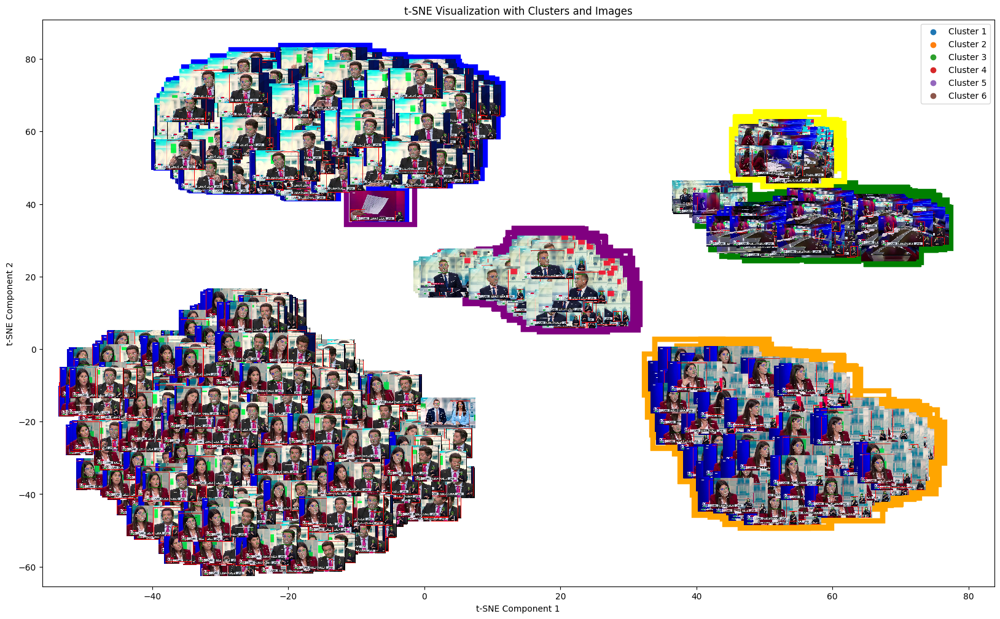

In [7]:
# Perform Spectral Clustering on the normalized embeddings with increased neighbors
num_clusters = 6
spectral = SpectralClustering(n_clusters=num_clusters, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
cluster_assignments = spectral.fit_predict(normalized_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2500)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters and images with outlines in a single figure
fig, ax1 = plt.subplots(figsize=(20, 12))

# Define the zoom level for images
zoom_level = 0.05

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o')

    for idx in scenes[i]:
        image_path = os.path.join('processed', video, filename[idx])
        image = Image.open(image_path)
        width, height = image.size
        imagebox = OffsetImage(image, zoom=zoom_level)
        ab = AnnotationBbox(imagebox, embeddings_tsne[idx], frameon=False)
        ax1.add_artist(ab)
        # Calculate the position of the rectangle based on the bounding box of the image
        box = ab.get_window_extent(fig.canvas.get_renderer())
        box_coords = box.transformed(ax1.transData.inverted())
        rect = Rectangle((box_coords.x0, box_coords.y0), box_coords.width+1, box_coords.height+1, 
                         fill=False, edgecolor=colors[i], linewidth=6)
        ax1.add_patch(rect)

ax1.set_title('t-SNE Visualization with Clusters and Images')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

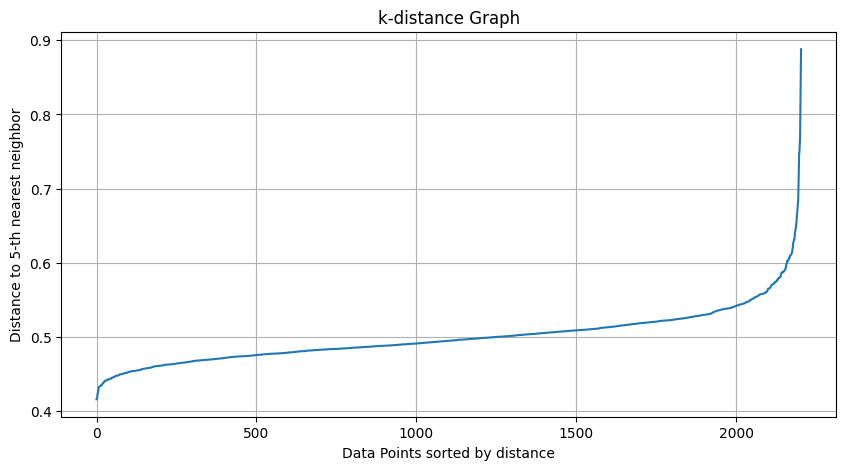

In [8]:
from sklearn.neighbors import NearestNeighbors

# Calculate the distances to the k-th nearest neighbors
k = 5  # This is the 'min_samples' parameter you might want to use in DBSCAN
nearest_neighbors = NearestNeighbors(n_neighbors=k)
neighbors = nearest_neighbors.fit(normalized_embeddings)
distances, indices = neighbors.kneighbors(normalized_embeddings)

# Sort the distances and plot the k-distance graph
distances = np.sort(distances[:, k-1], axis=0)
plt.figure(figsize=(10, 5))
plt.plot(distances)
plt.xlabel('Data Points sorted by distance')
plt.ylabel('Distance to {}-th nearest neighbor'.format(k))
plt.title('k-distance Graph')
plt.grid(True)
plt.show()

In [18]:
# Function to perform DBSCAN and compute the Silhouette Score
def evaluate_dbscan(eps, min_samples):
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(normalized_embeddings)
    if len(set(cluster_labels)) > 1:  # To ensure there are more than one cluster
        score = silhouette_score(normalized_embeddings, cluster_labels)
        return score
    else:
        return -1  # Return a low score if there's only one cluster

# Initial grid search over eps and min_samples
eps_values = np.arange(0.5, 0.6, 0.01)
min_samples_values = range(3, 10)
best_score = -1
best_params = None

for eps in eps_values:
    for min_samples in min_samples_values:
        score = evaluate_dbscan(eps, min_samples)
        if score > best_score:
            best_score = score
            best_params = (eps, min_samples)

print(f'Initial best parameters: eps={best_params[0]}, min_samples={best_params[1]}, silhouette_score={best_score}')

# Fine-tuning with higher precision
best_eps, best_min_samples = best_params
eps_values_fine = np.arange(best_eps - 0.01, best_eps + 0.01, 0.001)

for eps in eps_values_fine:
    score = evaluate_dbscan(eps, best_min_samples)
    if score > best_score:
        best_score = score
        best_params = (eps, best_min_samples)

print(f'Fine-tuned best parameters: eps={best_params[0]:.4f}, min_samples={best_params[1]}, silhouette_score={best_score}')

# Further fine-tuning to 4 decimal places
best_eps = best_params[0]
eps_values_finer = np.arange(best_eps - 0.001, best_eps + 0.001, 0.0001)


for eps in eps_values_finer:
    score = evaluate_dbscan(eps, best_min_samples)
    if score > best_score:
        best_score = score
        best_params = (eps, best_min_samples)

print(f'Further fine-tuned best parameters: eps={best_params[0]:.4f}, min_samples={best_params[1]}, silhouette_score={best_score}')


Initial best parameters: eps=0.54, min_samples=3, silhouette_score=0.15853825152775655
Fine-tuned best parameters: eps=0.5470, min_samples=3, silhouette_score=0.15977551046989513
Further fine-tuned best parameters: eps=0.5470, min_samples=3, silhouette_score=0.15977551046989513


C:\Users\maria\AppData\Local\Temp\ipykernel_18436\3613067211.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', num_clusters + 1)


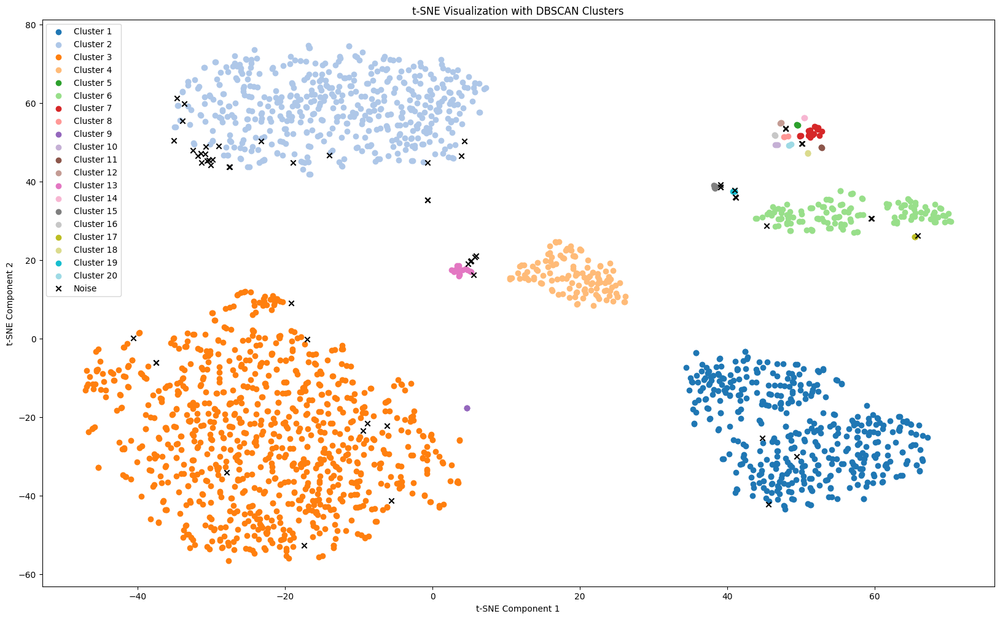

In [30]:
# Perform DBSCAN on the original high-dimensional embeddings
dbscan = DBSCAN(eps=0.547, min_samples=best_params[1])  # Adjust eps and min_samples as needed
cluster_assignments = dbscan.fit_predict(normalized_embeddings)

# Number of clusters in labels, ignoring noise if present
num_clusters = len(set(cluster_assignments)) - (1 if -1 in cluster_assignments else 0)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    if cluster != -1:  # Ignore noise points
        scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2000)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

# Generate a list of distinct colors using tab20 colormap for more variety
colors = plt.cm.get_cmap('tab20', num_clusters + 1)

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors(i))

# Plot noise points if present
if -1 in cluster_assignments:
    ax1.scatter(embeddings_tsne[cluster_assignments == -1, 0], 
                embeddings_tsne[cluster_assignments == -1, 1], 
                label='Noise', marker='x', color='black')

ax1.set_title('t-SNE Visualization with DBSCAN Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

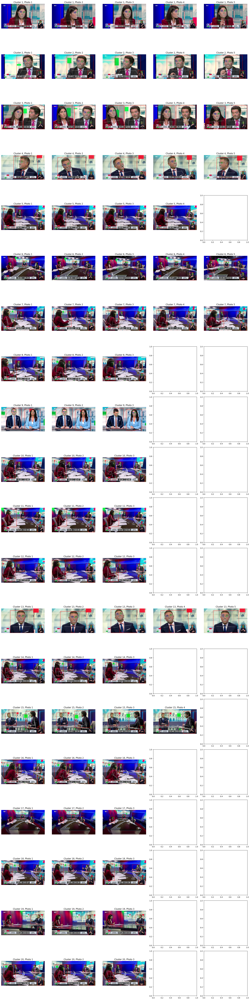

In [31]:
# Plot 5 random images from each cluster
fig, axs = plt.subplots(num_clusters, 5, figsize=(20, 4 * num_clusters))
for cluster_id, scene in enumerate(scenes):
    random_photos = random.sample(scene, min(5, len(scene)))  # Select 5 random photos or less if not enough photos
    for i, photo_id in enumerate(random_photos):
        image_path = os.path.join('processed', video, filename[photo_id])
        img = Image.open(image_path)
        axs[cluster_id, i].imshow(img)
        axs[cluster_id, i].axis('off')
        axs[cluster_id, i].set_title(f'Cluster {cluster_id + 1}, Photo {i + 1}')

plt.tight_layout()
plt.show()

## Take out outliers

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


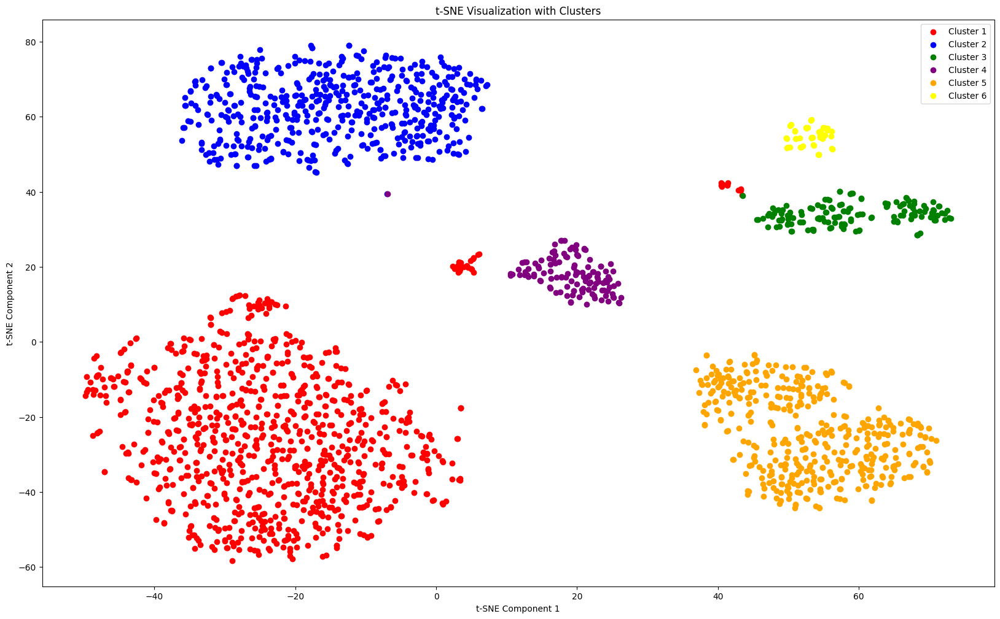

In [ ]:
# Normalize embeddings
embeddings = np.vstack(embedding)  # Convert the column to a 2D NumPy array
norm = np.linalg.norm(embeddings, axis=1, keepdims=True)
normalized_embeddings = embeddings / norm

# Perform Spectral Clustering on the normalized embeddings with increased neighbors
num_clusters = 6
spectral = SpectralClustering(n_clusters=num_clusters, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
cluster_assignments = spectral.fit_predict(normalized_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2500)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


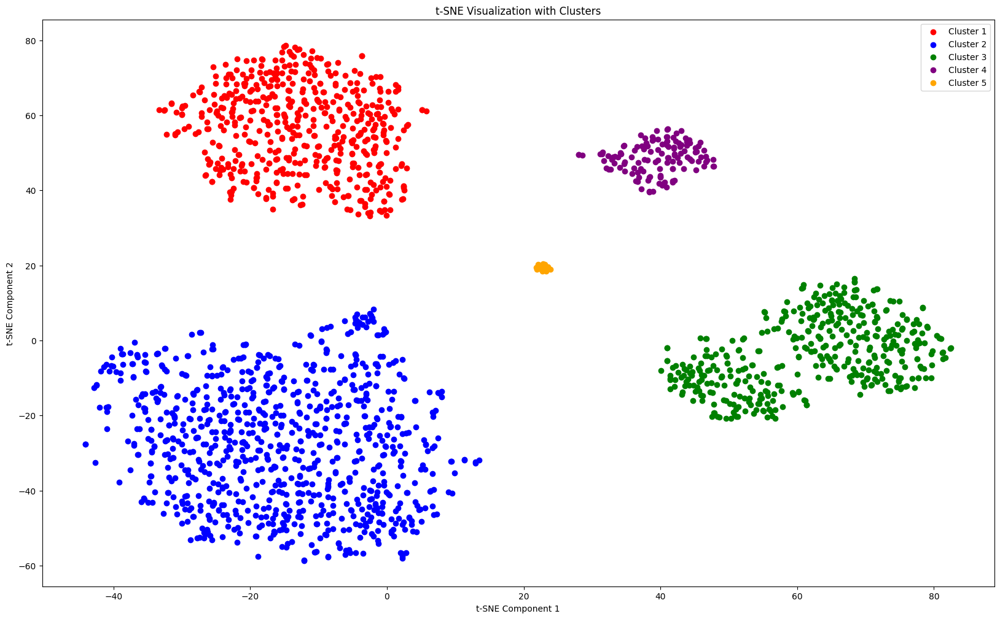

In [75]:
from pyod.models.iforest import IForest  # Importing Isolation Forest from pyod

# Detect and remove outliers using Isolation Forest from pyod
iso_forest = IForest(contamination=0.1, random_state=42)
iso_forest.fit(normalized_embeddings)
outlier_labels = iso_forest.labels_
inlier_indices = np.where(outlier_labels == 0)[0]

# Keep only inliers
filtered_embeddings = normalized_embeddings[inlier_indices]
filtered_filenames = filename.iloc[inlier_indices]

# Perform Spectral Clustering on the filtered embeddings
num_clusters = 5
spectral = SpectralClustering(n_clusters=num_clusters, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
cluster_assignments = spectral.fit_predict(filtered_embeddings)

scenes = [[] for _ in range(num_clusters)]
for i, cluster in enumerate(cluster_assignments):
    scenes[cluster].append(i)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2500)
embeddings_tsne = tsne.fit_transform(filtered_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[cluster_assignments == i, 0], 
                embeddings_tsne[cluster_assignments == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

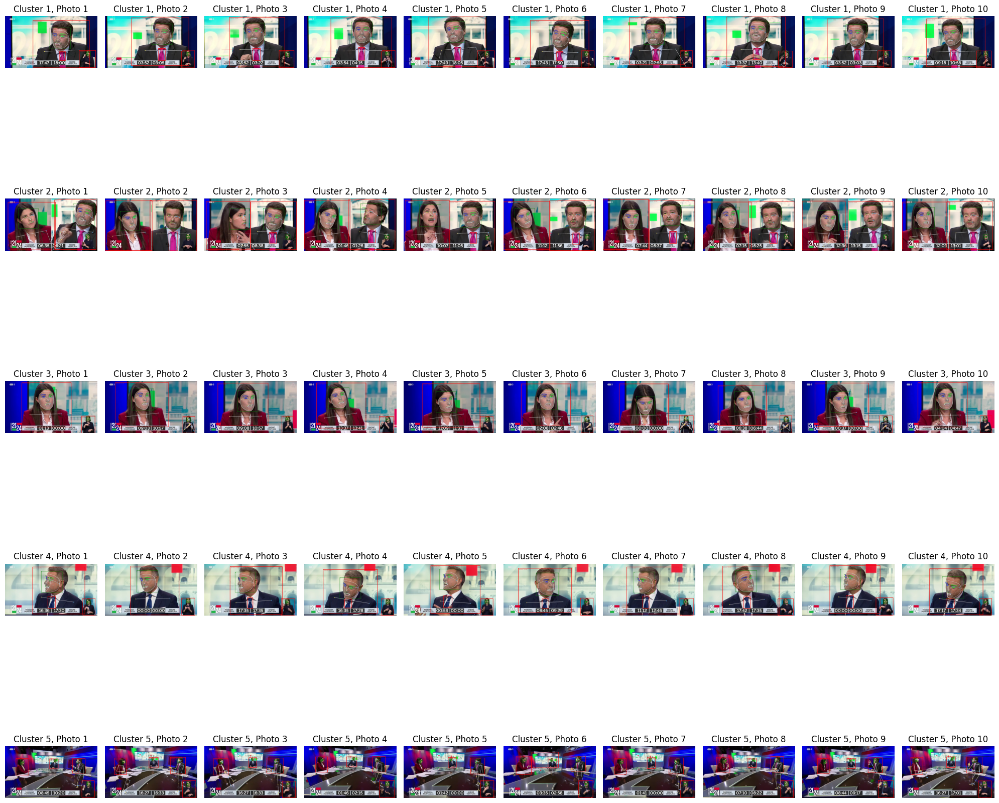

In [70]:
# Function to plot random images from each cluster
def plot_random_images_from_clusters(num_pics):
    fig, axs = plt.subplots(num_clusters, num_pics, figsize=(20, 4 * num_clusters))
    
    for cluster_id, scene in enumerate(scenes):
        random_photos = random.sample(scene, min(num_pics, len(scene)))  # Select num_pics random photos or less if not enough photos
        for i, photo_id in enumerate(random_photos):
            image_path = os.path.join('processed', video, filtered_filenames.iloc[photo_id])
            img = Image.open(image_path)
            axs[cluster_id, i].imshow(img)
            axs[cluster_id, i].axis('off')
            axs[cluster_id, i].set_title(f'Cluster {cluster_id + 1}, Photo {i + 1}')

    plt.tight_layout()
    plt.show()

# Plot 5 random images from each cluster
plot_random_images_from_clusters(10)

C:\Users\maria\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:301: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


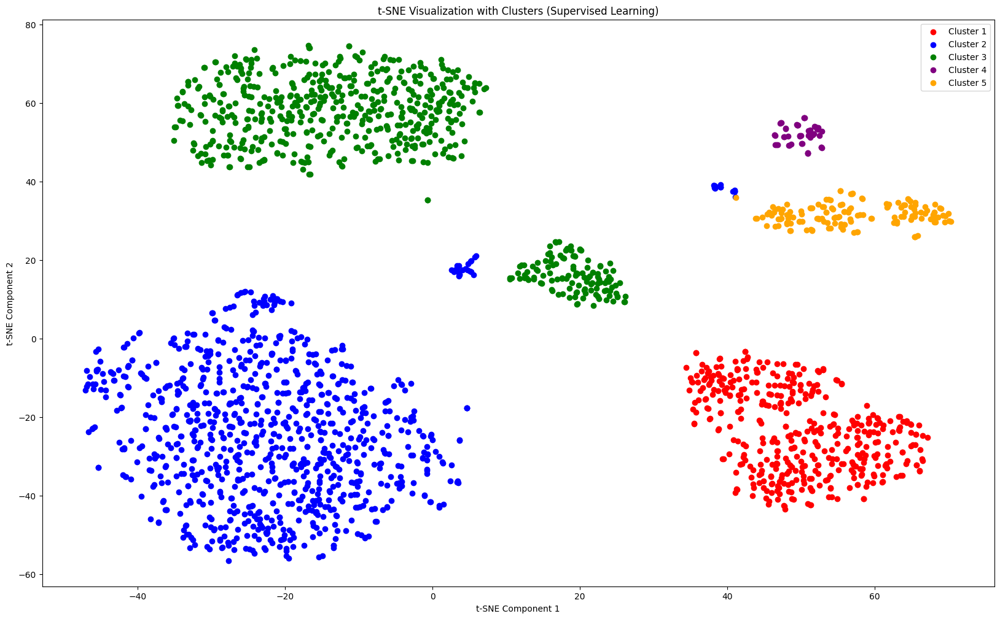

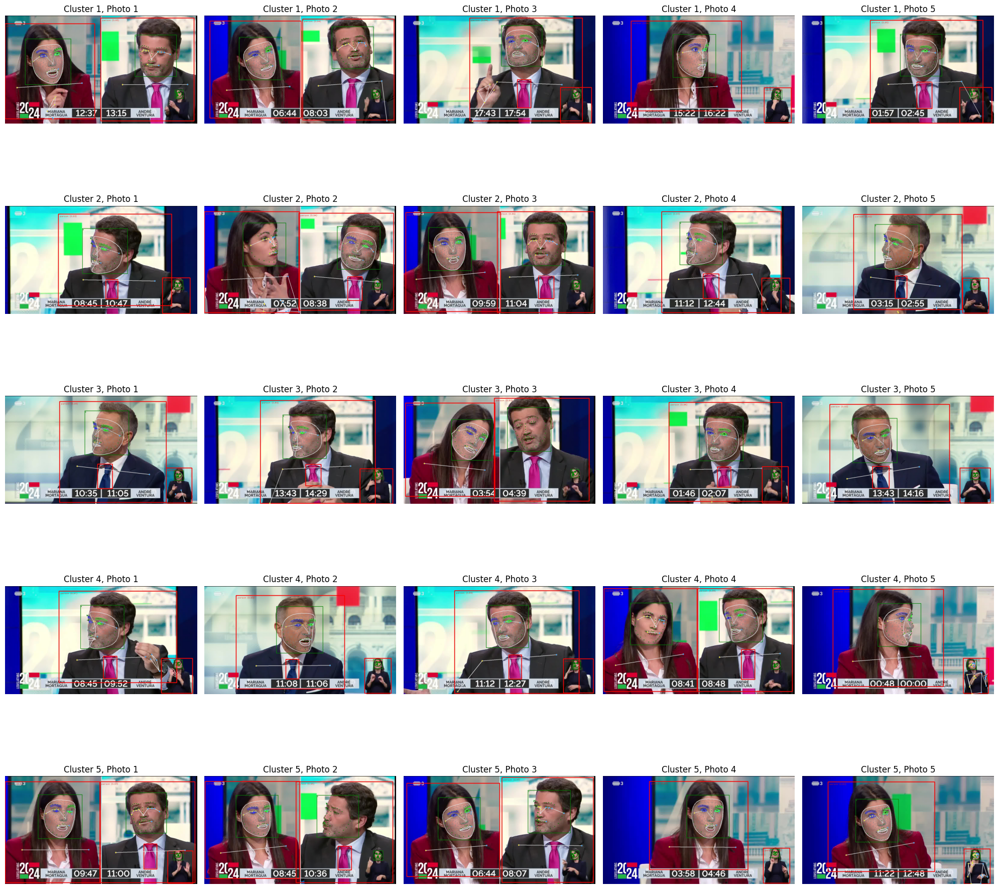

In [76]:
from sklearn.ensemble import RandomForestClassifier

# Detect and remove outliers using Isolation Forest from pyod
iso_forest = IForest(contamination=0.001, random_state=42)
iso_forest.fit(normalized_embeddings)
outlier_labels = iso_forest.labels_
inlier_indices = np.where(outlier_labels == 0)[0]

# Keep only inliers
filtered_embeddings = normalized_embeddings[inlier_indices]
filtered_filenames = filename.iloc[inlier_indices]

# Perform Spectral Clustering on the filtered embeddings
num_clusters = 5
spectral = SpectralClustering(n_clusters=num_clusters, random_state=42, affinity='nearest_neighbors', n_neighbors=10)
cluster_assignments = spectral.fit_predict(filtered_embeddings)

# Train a RandomForestClassifier using the filtered embeddings and their cluster labels
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(filtered_embeddings, cluster_assignments)

# Apply the trained model to classify the original embeddings
predicted_labels = rf_classifier.predict(normalized_embeddings)

# Apply t-SNE for visualization purposes
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=2000)
embeddings_tsne = tsne.fit_transform(normalized_embeddings)

# Plot clusters as points
fig, ax1 = plt.subplots(figsize=(20, 12))

colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow']

for i in range(num_clusters):
    ax1.scatter(embeddings_tsne[predicted_labels == i, 0], 
                embeddings_tsne[predicted_labels == i, 1], 
                label=f'Cluster {i+1}', marker='o', color=colors[i])

ax1.set_title('t-SNE Visualization with Clusters (Supervised Learning)')
ax1.set_xlabel('t-SNE Component 1')
ax1.set_ylabel('t-SNE Component 2')
ax1.legend()

plt.show()

# Plot 5 random images from each cluster
plot_random_images_from_clusters(5)

task:
- Automatizar no de clusters